# Testing Model

In [33]:
import pandas as pd
import pickle
import json
import os

# Function to convert timestamp to Martian day (ignores the year, focuses on day of the Martian year)
def to_martian_day(timestamp):
    # Extract month, day, hour, and minute to represent the Martian day
    return (timestamp.month, timestamp.day, timestamp.hour, timestamp.minute)

# Load the test data
test_data = pd.read_csv('Trial.csv')
test_data['ut_ms'] = pd.to_datetime(test_data['ut_ms'])
test_data.set_index('ut_ms', inplace=True)

# Load metadata
with open('models_pickle/metadata.json', 'r') as f:
    metadata = json.load(f)

# Function to find the best model for a given timestamp from the metadata
def find_model_for_timestamp(timestamp):
    martian_day = to_martian_day(timestamp)  # Convert to Martian day representation
    for entry in metadata:
        start_time = pd.to_datetime(entry['start_time'])
        end_time = pd.to_datetime(entry['end_time'])
        
        # Convert start and end times to Martian day representations
        martian_start = to_martian_day(start_time)
        martian_end = to_martian_day(end_time)
        
        # Debugging: print metadata ranges for reference
        print(f"Checking model {entry['model_name']} from {martian_start} to {martian_end} for timestamp {martian_day}")

        # Check if the Martian day falls within this range
        if martian_start <= martian_day <= martian_end:
            return entry['file_path']
    
    return None

# Initialize a list to store predictions
predictions = []

# Cache to store loaded models to avoid reloading the same model multiple times
model_cache = {}

# Iterate over the test data in windows (you can customize the window size as per your need)
for timestamp, row in test_data.iterrows():
    # Find the correct model for the current timestamp
    model_file = find_model_for_timestamp(timestamp)
    
    if model_file is None:
        print(f"No model found for timestamp: {timestamp}")
        continue
    
    # Load the correct model (use a cache to avoid reloading the same model multiple times)
    if model_file in model_cache:
        model = model_cache[model_file]
    else:
        with open(model_file, 'rb') as f:
            model = pickle.load(f)
        model_cache[model_file] = model

    # Load the features used in the training model from the metadata
    training_columns = None
    if hasattr(model, 'get_booster'):
        booster = model.get_booster()
        if booster is not None and hasattr(booster, 'feature_names'):
            training_columns = booster.feature_names
    elif hasattr(model, 'feature_importances_'):
        training_columns = row.index  # Adjust as needed if the feature_importances_ is available

    # Ensure that `training_columns` is not None
    if training_columns is None:
        print(f"Warning: No feature names available for model at timestamp: {timestamp}")
        continue

    # **Strict match: Reindex test row to exactly match training features**
    X_test = row.reindex(training_columns, fill_value=0).values.reshape(1, -1)

    # **Ensure feature alignment before prediction**
    if X_test.shape[1] != len(training_columns):
        print(f"Feature mismatch for timestamp {timestamp}: Expected {len(training_columns)} but got {X_test.shape[1]}")
        continue

    # Make prediction for this row
    try:
        predicted_value = model.predict(X_test)
        predictions.append((timestamp, predicted_value[0]))
    except ValueError as ve:
        print(f"Prediction error for timestamp {timestamp}: {ve}")
        continue

# Convert predictions into a DataFrame
predictions_df = pd.DataFrame(predictions, columns=['timestamp', 'predicted_value'])

# Save or display the predictions
print(predictions_df.head())


Checking model XGBoost from (8, 22, 0, 0) to (8, 22, 7, 0) for timestamp (7, 10, 0, 0)
Checking model RandomForest from (8, 22, 6, 0) to (8, 22, 19, 0) for timestamp (7, 10, 0, 0)
Checking model CatBoost from (8, 22, 18, 0) to (8, 23, 1, 0) for timestamp (7, 10, 0, 0)
Checking model XGBoost from (8, 23, 0, 0) to (8, 23, 7, 0) for timestamp (7, 10, 0, 0)
Checking model RandomForest from (8, 23, 6, 0) to (8, 23, 13, 0) for timestamp (7, 10, 0, 0)
Checking model CatBoost from (8, 23, 12, 0) to (8, 24, 1, 0) for timestamp (7, 10, 0, 0)
Checking model RandomForest from (8, 24, 0, 0) to (8, 25, 1, 0) for timestamp (7, 10, 0, 0)
Checking model XGBoost from (8, 25, 0, 0) to (8, 25, 7, 0) for timestamp (7, 10, 0, 0)
Checking model CatBoost from (8, 25, 6, 0) to (8, 25, 19, 0) for timestamp (7, 10, 0, 0)
Checking model RandomForest from (8, 25, 18, 0) to (8, 26, 1, 0) for timestamp (7, 10, 0, 0)
Checking model CatBoost from (8, 26, 0, 0) to (8, 26, 7, 0) for timestamp (7, 10, 0, 0)
Checking mode

In [34]:
predictions_df

,timestamp,predicted_value
0,2010-07-10 00:00:00,0.138301
1,2010-07-10 00:15:00,0.187405
2,2010-07-10 00:30:00,0.187405
3,2010-07-10 00:45:00,0.138301
4,2010-07-10 00:52:00,0.138301
...,...,...
214,2010-07-12 07:04:00,0.201391
215,2010-07-12 07:07:00,0.157195
216,2010-07-12 07:15:00,0.160904
217,2010-07-12 07:30:00,0.153728


In [35]:
predictions_df.to_csv('Predicted.csv')

# Visualizing prediction error on training model

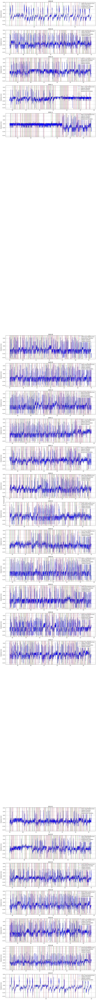

In [24]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np
import pandas as pd
import json
import pickle

# Load metadata from the json file
with open('models_pickle/metadata.json', 'r') as f:
    metadata = json.load(f)

# Find the best overall model
best_model_path = best_model_info['file_path']


# Load the best model from the pickle file
with open(best_model_path, 'rb') as f:
    best_model = pickle.load(f)

# Remove added columns ('day', 'month', 'year', 'month_year') before prediction
columns_to_drop = ['NPWD2372', 'day', 'month', 'year', 'month_year']
X_test = scaler.transform(merged_data.drop(columns=columns_to_drop, errors='ignore'))  # Drop unnecessary columns before prediction
y_test = merged_data['NPWD2372']

# Make predictions
y_pred = best_model.predict(X_test)

# Calculate prediction error
prediction_error = y_test - y_pred

# Add 'year' and 'month' columns for visualization purposes only
merged_data['year'] = merged_data.index.year
merged_data['month'] = merged_data.index.month

# Unique years and months for separate plots
unique_years = merged_data['year'].unique()
unique_months = merged_data['month'].unique()

# Create a figure with one subplot per month, stacked vertically
n_plots = len(unique_years) * len(unique_months)

fig, axes = plt.subplots(n_plots, 1, figsize=(14, 4 * n_plots), sharex=False)

# Ensure axes is always iterable, even for a single plot
if n_plots == 1:
    axes = [axes]

model_colors = {
    'XGBoost': 'green',
    'RandomForest': 'red',
    'CatBoost': 'purple'
}

plot_index = 0  # Index to iterate over the axes

# Loop over each year and month, and plot data for that specific month in that year
for year in unique_years:
    for month in unique_months:
        ax = axes[plot_index]  # Get the correct axis for this plot
        
        # Filter data for the current year and month
        monthly_data = merged_data[(merged_data['year'] == year) & (merged_data['month'] == month)]
        
        # If there's no data for this month, skip the plot
        if monthly_data.empty:
            ax.axis('off')  # Turn off the plot if there's no data for this month
            plot_index += 1
            continue
        
        # Group prediction error by day (or timestamp) within the specific month
        daily_error = prediction_error[monthly_data.index]
        
        # Plot the daily prediction error for the current month of the year
        ax.plot(daily_error.index, daily_error, label=f'{year}-{month} Avg Prediction Error', color='blue', linewidth=1)
        
        # Mark the transitions in models with vertical lines only for this month of the year
        for entry in metadata:
            model_name = entry['model_name']
            model_start_time = pd.to_datetime(entry['start_time'])
            
            # If the model transition happened in this month of the year, plot it
            if model_start_time.year == year and model_start_time.month == month:
                ax.axvline(x=model_start_time, color=model_colors.get(model_name, 'black'), linestyle='--', label=f'{model_name} Transition')

        # Add labels and titles for each subplot
        ax.set_title(f'{year}-{month:02d}')
        ax.set_ylabel('Prediction Error')

        # Format the x-axis to show day of the month
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%d'))
        ax.xaxis.set_major_locator(mdates.DayLocator(interval=5))  # Show every 5 days

        # Ensure the legend only shows unique labels
        handles, labels = ax.get_legend_handles_labels()
        by_label = dict(zip(labels, handles))
        ax.legend(by_label.values(), by_label.keys(), loc='upper right')
        ax.grid(True)
        
        plot_index += 1

# Set common x-axis and y-axis labels
fig.text(0.5, 0.04, 'Day of Month', ha='center')
fig.text(0.04, 0.5, 'Prediction Error', va='center', rotation='vertical')

# Adjust layout to prevent overlap between subplots
plt.tight_layout()
plt.show()
